# 흐린사진을 선명하게

학습된 SRGAN, SRCNN 모델을 사용하여 이미지와 GIF의 해상도 개선 여부를 확인하고자 합니다. 이미지는 '야간에 촬영한 이미지', '아웃포커싱된 이미지', '질감이 느껴지는 이미지', '먼 거리의 구조물에 대한 이미지'를 사용하고자 합니다. GIF는 '야간에 촬영한 GIF', '게임 GIF'를 이용 합니다. 모델의 출력에 대한 객관적인 지표로는 PSNR과 SSIM을 이용합니다. 평가 지표와 실제 육안으로 확인하였을 때의 해상도 개선은 다를 수 있기 때문에 실제 육안으로 이미지를 확인하여 평가하고자 합니다.

## 데이터
사용하는 이미지는 총 네 장으로 각각 '불꽃놀이', '꽃', '바다', '관람차'에 대한 이미지 입니다. 모든 이미지는 세로 1,728, 가로 2,592이고 컬러 입니다.

#### 라이브러리 

In [1]:
import os   #디렉토리 관리
import cv2   #이미지 처리
import numpy as np   #행렬 연산
import matplotlib.pyplot as plt   #데이터 시각화
from skimage.metrics import peak_signal_noise_ratio, structural_similarity   #이미지 평가 지표


import tensorflow as tf   #신경망


import imageio   #gif 저장
from IPython.display import Image as show_gif   #gif 시각화

#### 이미지 불러오기

In [2]:
def load_img(img_path, width_size=2592):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    height_size = int(img.shape[0] / (img.shape[1] / width_size))
    img = cv2.resize(img, dsize=(width_size, height_size))
    return img


hanabi = load_img("./dataset/hanabi.jpg")
hana = load_img("./dataset/hana.jpg")
umi = load_img("./dataset/umi.png")
kanran = load_img("./dataset/kanran.jpg")

#### 시각화
예제에 사용할 이미지를 시각화 합니다. 이미지는 총 네 장으로 `IMAGE 1(불꽃놀이)`, `IMAGE 2(꽃)`, `IMAGE 3(바다)`, `IMAGE 4(관람차)`에 대한 이미지 입니다.모든 이미지는 세로 1,728, 가로 2,592 크기 입니다.

In [3]:
#이미지 시각화 함수
def draw_sub_img(img, title):
    plt.title(title, size= 15)
    plt.tick_params(
        axis='both', bottom=False, left=False,
        labelbottom=False, labelleft=False
    )
    
    plt.xlabel(img.shape[1])
    plt.ylabel(img.shape[0])
    plt.imshow(img)


#이미지 시각화 시행
image_list = [hanabi, hana, umi, kanran]

plt.figure(figsize=(16, 12))
for idx, img in enumerate(image_list):
    plt.subplot(2, 2, idx+1)
    draw_sub_img(img, "IMAGE {0}".format(idx+1))

plt.show()

## 이미지 해상도 개선
이미지 해상도 개선을 위해 SRGAN과 SRCNN은 학습되어진 모델을 사용합니다. 이미지 해상도 개선은 앞서 소개한 네 장의 이미지를 이용하며,  원본 이미지와 모델의 출력 이미지를 비교하기 위해 PSNR과 SSIM 값을 확인하고자 합니다. 나아가 이미지의 특정 세부 영역의 해상도 개선 확인도 함께 실시 합니다. 따라서, 세부 영역을 선정하고 각 모델의 해상도 개선을 시각화 할 것입니다.

#### 학습된 모델 불러오기
이미지 해상도 개선을 위한 `SRGAN`, `SRCNN` 모델을 불러옵니다.

In [4]:
#SR GAN
model_file = './dataset/super_resolution/srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)


#SR CNN
model_file = './dataset/super_resolution/srcnn.h5'
srcnn = tf.keras.models.load_model(model_file)

#### 모델 후처리 함수 생성
`SRGAN`, `SRCNN` 모델의 출력을 후처리 하는 함수를 생성 합니다.

In [5]:
#SR GAN
def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]


#SR CNN
def apply_srcnn(image):
    sr = srcnn.predict(image[np.newaxis, ...]/255.)
    sr[sr > 1] = 1
    sr[sr < 0] = 0
    sr *= 255.
    return np.array(sr[0].astype(np.uint8))

#### 필요 함수 생성
고화질의 이미지 크기를 축소하는 함수(`size_down_img`)와 크기를 복원하는 함수(`size_up_img`), 원본 이미지와 수정 이미지의 차이를 나타내는 지표인 `PSNR`과 `SSIM`을 출력하는 함수(`get_psnr_ssim`)를 생성 합니다.

In [6]:
def size_down_img(img):
    c_img = img.copy()
    bicubic_img = cv2.resize(
        c_img, 
        dsize=(int(img.shape[1] / 4), int(img.shape[0] / 4)),
        interpolation=cv2.INTER_CUBIC # bicubic interpolation 적용
    )
    return bicubic_img


def size_up_img(img):
    c_img = img.copy()
    sizeup_hr = cv2.resize(
        c_img, 
        dsize=(bicubic_img.shape[1] * 4, bicubic_img.shape[0] * 4), # 고해상도 이미지 크기로 설정
        interpolation=cv2.INTER_CUBIC # bicubic interpolation 적용
    )
    return sizeup_hr


def get_psnr_ssim(image_list, origin):
    psnr = [round(peak_signal_noise_ratio(origin, i), 3) for i in image_list]
    ssim = [round(structural_similarity(origin, i, multichannel=True), 3) for i in image_list]
    return (psnr, ssim)

### '불꽃놀이' 이미지 해상도 개선
불꽃놀이 이미지의 특징으로는 야간에 촬영한 이미지로 아주 약간의 노이즈가 있으며, 폭죽에 의한 빛과 여러 구조물 및 인물의 뒷모습 등을 확인할 수 있습니다. 폭죽 및 가로등의 빛은 밝지만, 인물의 뒷모습은 어둡기 때문에 밝기에 대한 고차가 있습니다.

### 이미지 해상도 개선
Bicubic의 경우 PSNR이 23.23, SSIM이 0.522였고 SRGAN의 경우 PSNR이 19.101, SSIM이 0.311, SRCNN의 경우 PSNR이 20.728, SSIM이 0.445임을 확인 하였습니다. 육안으로 각 이미지를 비교하였을 때, SRGAN의 경우 이미지가 더 선명해 졌지만, 노이즈는 더 증가하였습니다. SRCNN의 경우 이미지의 빛이 번진 것 처럼 보이며, 노이즈는 더 증가하였습니다.

#### 이미지 시각화
`IMAGE 1(불꽃놀이)`의 원본 이미지를 시각화 합니다.

In [7]:
plt.figure(figsize=(17, 12))
draw_sub_img(hanabi, "<Fig. 1> Original IMAGE 1")
plt.show()

#### 이미지 축소
`SRGAN` 모델에 입력을 위해 원본 이미지를 1/4 크기로 축소 합니다.
이미지의 크기가 세로 1,728, 가로 2,592에서 세로 432, 648로 축소 된 것을 확인 할 수 있습니다.

In [8]:
print("*" * 50)
print(hanabi.shape)
bicubic_img = size_down_img(hanabi)

print("↓" * 25)
print(bicubic_img.shape)
print("*" * 50)

#### SRGAN을 이용한 이미지 해상도 개선
앞서 축소한 이미지를 `SRGAN`에 입력하여 이미지 해상도를 복원합니다. 세로 432, 가로 648 크기의 이미지가 원본 이미지의 크기로 복원된 것을 확인 할 수 있습니다.

In [9]:
print("*" * 50)
print(bicubic_img.shape)

srgan_img = apply_srgan(bicubic_img)
print("↓" * 25)
print(srgan_img.shape)
print("*" * 50)

#### SRCNN을 이용한 이미지 해상도 개선
원본 이미지에 대해 축소한 이미지(432 x 648)를 재차 크기를 키워(1,728 x 2,592) 이를 `SRCNN`을 통해 해상도 개선(1,728 x 2,592)을 실시 합니다.

In [10]:
print("*" * 50)
print(bicubic_img.shape)

bicubic_img = size_up_img(bicubic_img)
print("↓" * 25)
print(bicubic_img.shape)

srcnn_img = apply_srcnn(bicubic_img)
print("↓" * 25)
print(srcnn_img.shape)
print("*" * 50)

#### 해상도 개선 결과 시각화 하기
각 모델을 통해 개선된 해상도 이미지와 `PSNR` 및 `SSIM` 지표를 함께 시각화 합니다.
순서대로 '원본 이미지', '축소 후 확대(Bicubic)', 'SRGAN의 출력 이미지', 'SRCNN의 출력 이미지' 입니다.
원본 이미지와 모델이 출력한 이미지의 차이를 나타내는 지표를 확인한 결과, `Bicubic`의 경우 `PSNR`이 23.23, `SSIM`이 0.522였고 `SRGAN`의 경우 `PSNR`이 19.101, `SSIM`이 0.311, `SRCNN`의 경우 `PSNR`이 20.728, `SSIM`이 0.445임을 확인 하였습니다.

In [11]:
images = [hanabi, bicubic_img, srgan_img, srcnn_img]
titles = ["ORIGINAL", "Bicubic", "SRGAN", "SRCNN"]
psnr, ssim = get_psnr_ssim(images, hanabi)

plt.figure(figsize=(17, 48))

for i in range(4):
    plt.subplot(4, 1, i+1)
    title = titles[i] + f" [PSNR: {psnr[i]} / SSIM: {ssim[i]}]"
    draw_sub_img(images[i], title)

### 이미지 세부 영역 분석
이미지를 크게 '직선 형태의 구조물'과 '폭죽의 중심부', '먼 거리의 객체'를 기준으로 세부 영역을 설정하고 이를 바탕으로 해상도 개선 여부를 확인하였습니다. 그 결과, 모든 영역에 대해 SRGAN이 SRCNN보다 PSNR 값이 낮고 SRCNN이 SRGAN보다 SSIM 값이 높은 것을 확인할 수 있습니다.

#### 세부 영역 표시, 영역 자르기 함수 생성
이미지의 특정 영역을 표시하는 함수(`rect_img`)와 자르는 함수(`crop_img`)를 생성 합니다.

In [13]:
def rect_img(
    img, rect_xy_list, rect_size_xy=(250, 150),
    color_list=(255, 0, 0), font_size=3, line_width=3
):
    c_img = img.copy()

    for idx, cut_xy in enumerate(rect_xy_list):
        cv2.rectangle(
            c_img,
            cut_xy, (cut_xy[0]+rect_size_xy[0], cut_xy[1]+rect_size_xy[1]),
            color_list, line_width, lineType=cv2.LINE_AA
        )
        cv2.putText(
            c_img, "({0})".format(idx+1),
            (cut_xy[0], cut_xy[1]-20),
            cv2.FONT_HERSHEY_PLAIN,
            font_size, color_list, font_size, cv2.LINE_AA
        )
    return c_img


def crop_img(img, cut_xy, cut_size_xy=(250, 150)):
    c_img = img.copy()
    c_img = c_img[
        cut_xy[1]:cut_xy[1]+cut_size_xy[1],
        cut_xy[0]:cut_xy[0]+cut_size_xy[0]
    ]
    return c_img

#### 세부 영역 표시 하기
난간을 지탱하는 세로 프레임의 해상도 개선, 폭죽에 대한 해상도 개선, 다리와 철골 구조를 잇는 와이어에 대한 해상도 개선을, 먼 거리에 있는 객체에 대한 해상도 개선, 폭죽에 대한 해상도 개선 을 확인하기 위해 선택하였습니다.

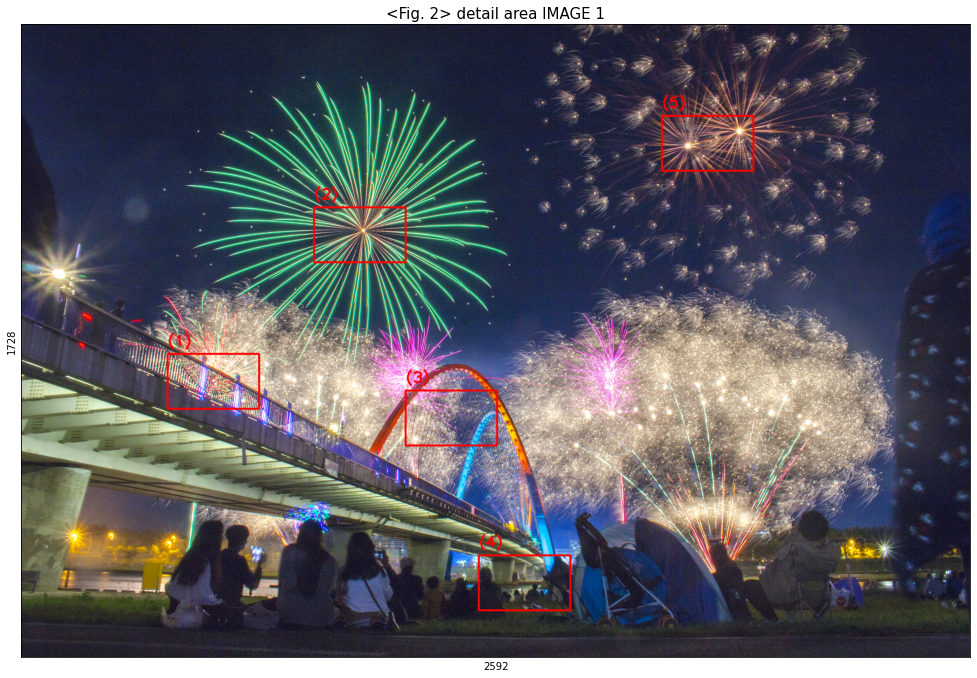

In [14]:
cut_xy_list = ((400, 900), (800, 500), (1050, 1000), (1250, 1450), (1750, 250))
c_img = rect_img(hanabi, cut_xy_list)

plt.figure(figsize=(17, 12))
draw_sub_img(c_img, "<Fig. 2> detail area IMAGE 1")
plt.show()

#### 세부 영역별 PSNR & SSIM 확인하기
선택한 세부 영역에 대한 이미지와 `PSNR`, `SSIM` 지표를 시각화 합니다. 모든 영역에 대해 `SRGAN`이 `SRCNN`보다 `PSNR` 값이 낮고 `SRCNN`이 `SRGAN`보다 `SSIM` 값이 높은 것을 확인할 수 있습니다.

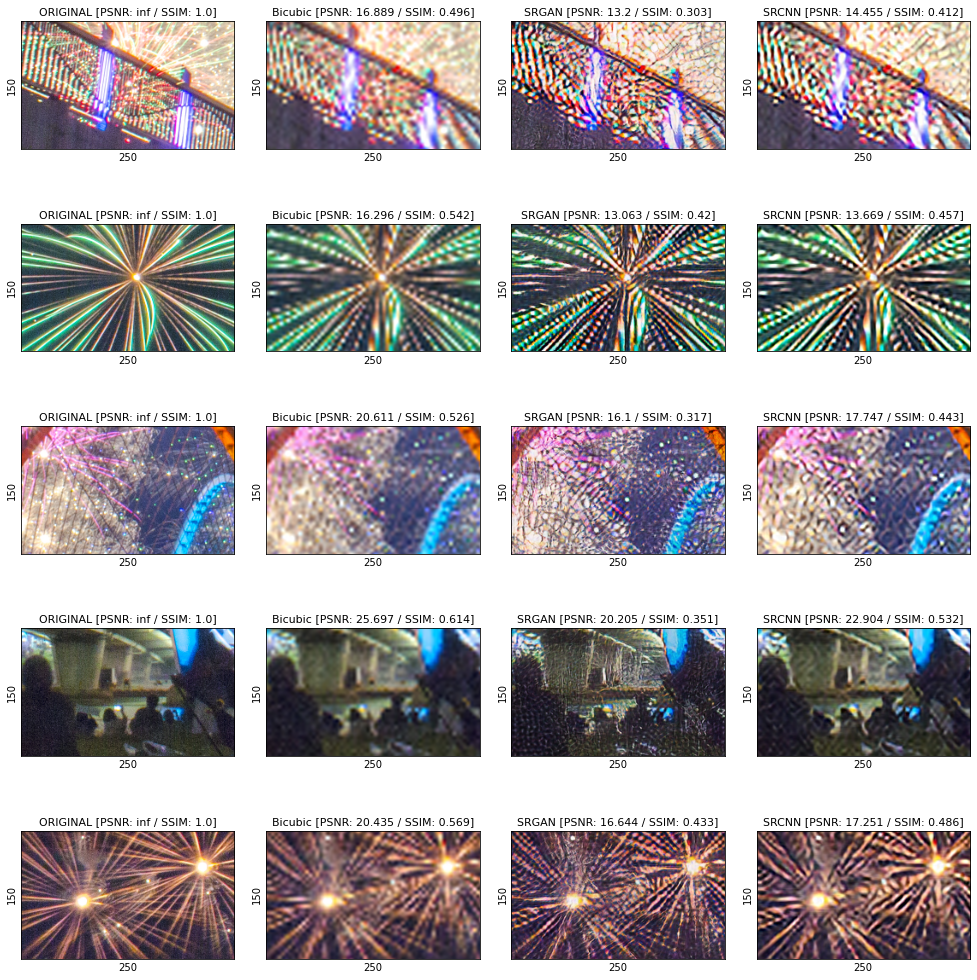

In [15]:
plt.figure(figsize=(17, 18))
plt.subplots_adjust(wspace=0.15)
for row, cut_xy in enumerate(cut_xy_list):
    origin_cut_img = crop_img(hanabi, cut_xy)

    cut_images = []
    for img in images:
        cut_images.append(crop_img(img, cut_xy))

    psnr, ssim = get_psnr_ssim(cut_images, origin_cut_img)

    for c in range(4):
        plt.subplot(len(cut_xy_list), 4, (row * 4 + c + 1))
        draw_sub_img(cut_images[c], "")
        plt.title(titles[c] + f" [PSNR: {psnr[c]} / SSIM: {ssim[c]}]", fontsize=11)

### '꽃' 이미지 해상도 개선
꽃 이미지의 특징은 아웃포커싱된 이미지 입니다. 뒤의 배경으로 갈 수록 이미지가 흐려지는 것을 볼 수 있습니다. 이러한 의도된 아웃포커싱이 모델을 통해 저해될 우려가 있으므로 이를 확인하기 위해 이미지로 사용하였습니다.

### 이미지 해상도 개선
Bicubic의 경우 PSNR이 36.087, SSIM이 0.891였고 SRGAN의 경우 PSNR이 27.659, SSIM이 0.638, SRCNN의 경우 PSNR이 32.821, SSIM이 0.852임을 확인 하였습니다. 육안으로 각 이미지를 비교하였을 때, SRGAN의 경우 꽃 잎의 테두리가 인위적으로 선명해진 것 처럼 보입니다. 육안으로 뚜렷한 차이를 확인하기 어렵기 때문에 세부적인 영역을 확대하여 확인할 필요가 있습니다.

#### 이미지 시각화
`IMAGE 2(꽃)`의 원본 이미지를 시각화 합니다.

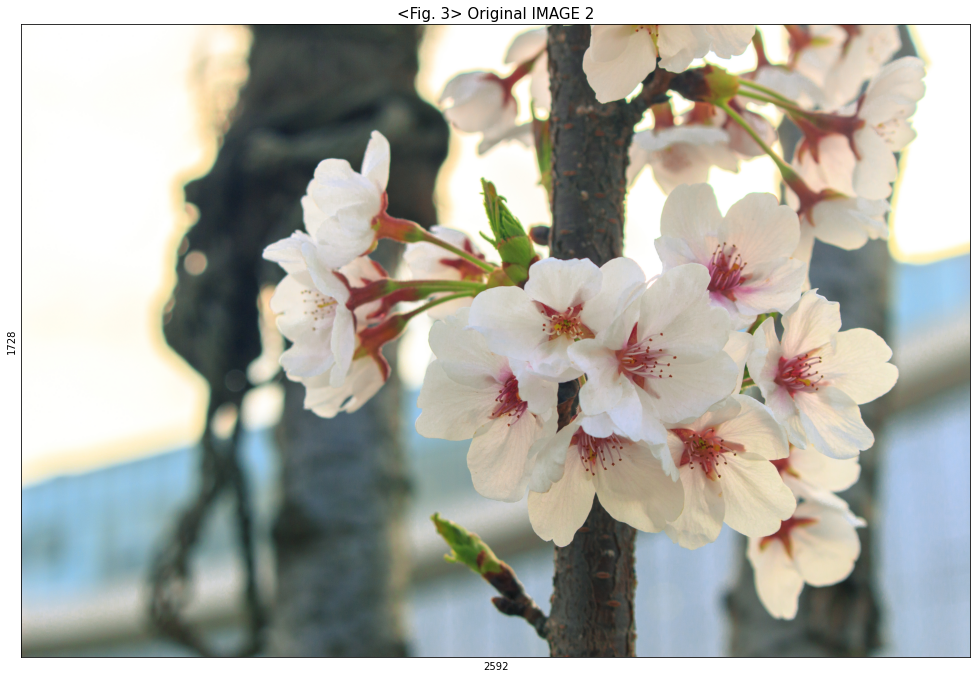

In [16]:
plt.figure(figsize=(17, 12))
draw_sub_img(hana, "<Fig. 3> Original IMAGE 2")
plt.show()

#### SRGAN, SRCNN 모델을 이용한 이미지 해상도 개선 실시
이전의 '이미지 축소', 'SRGAN을 이용한 해상도 개선', '이미지 확대(Bicubic)', 'SRCNN을 이용한 해상도 개선' 작업을 통합하여 실시 합니다.

In [17]:
bicubic_img = size_down_img(hana)   #이미지 축소
srgan_img = apply_srgan(bicubic_img)   #SRGAN
bicubic_img = size_up_img(bicubic_img)   #이미지 확대(Bicubic)
srcnn_img = apply_srcnn(bicubic_img)   #SRCNN

#### 해상도 개선 결과 시각화 하기
`Bicubic`의 경우 `PSNR`이 36.087, `SSIM`이 0.891였고 `SRGAN`의 경우 `PSNR`이 27.659, `SSIM`이 0.638, `SRCNN`의 경우 `PSNR`이 32.821, `SSIM`이 0.852임을 확인 하였습니다.

In [13]:
images = [hana, bicubic_img, srgan_img, srcnn_img]
titles = ["ORIGINAL", "Bicubic", "SRGAN", "SRCNN"]
psnr, ssim = get_psnr_ssim(images, hana)

plt.figure(figsize=(17, 48))

for i in range(4):
    plt.subplot(4, 1, i+1)
    title = titles[i] + f" [PSNR: {psnr[i]} / SSIM: {ssim[i]}]"
    draw_sub_img(images[i], title)

### 이미지 세부 영역 분석
개체의 먼 정도에 따라 세부 영역을 선정하였습니다. 원본 이미지의 경우 개체가 멀 수록 흐리게 보이며 모델에 따라 해상도 변화를 확인하고자 합니다. 그 결과, 모든 영역에 대해 SRGAN이 SRCNN보다 PSNR 값이 낮고 SRCNN이 SRGAN보다 SSIM 값이 높은 것을 확인할 수 있습니다.

육안으로 확인한 결과, 가장 가까운 꽃잎의 술 부분은 SRGAN의 경우 이미지가 선명하지만, 약간 각 진 부분이 보이며, SRCNN의 경우 선명하지 못한 것이 확인 됩니다. 또한 SRGAN의 경우 전체적으로 노이즈가 뚜렷하게 보이는 것을 확인 하였습니다.

#### 세부 영역 표시
선택한 세부 영역은 총 네 개이며 선택 이유는 거리에 따른 해상도 개선 정도를 확인하기 위함 입니다.

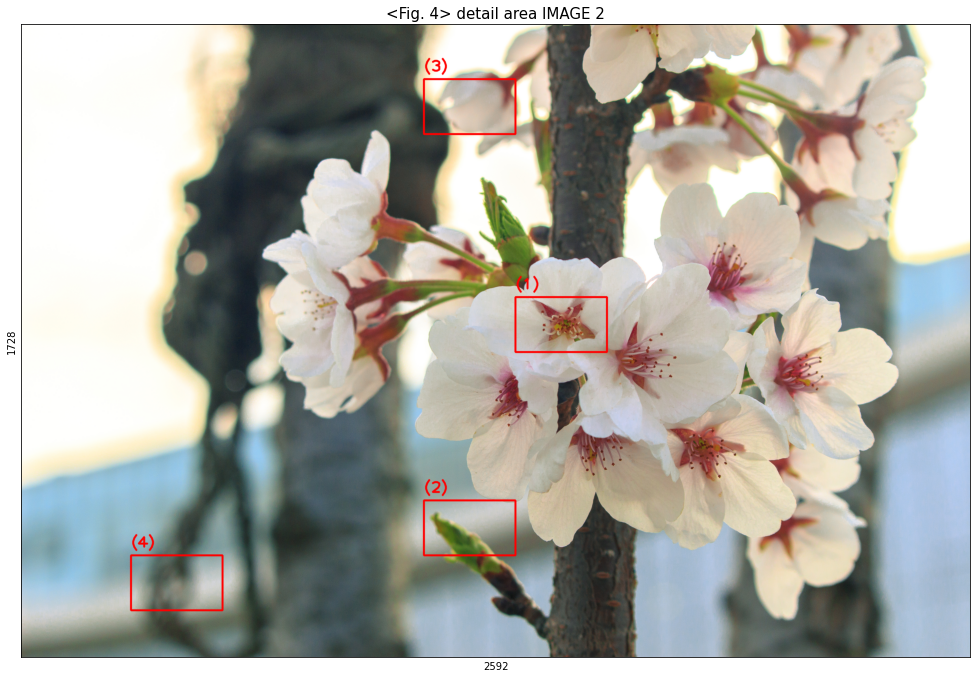

In [19]:
cut_xy_list = ((1350, 745), (1100, 1300), (1100, 150), (300, 1450))
c_img = rect_img(hana, cut_xy_list)

plt.figure(figsize=(17, 12))
draw_sub_img(c_img, "<Fig. 4> detail area IMAGE 2")
plt.show()

#### 세부 영역별 PSNR & SSIM 확인하기
선택한 세부 영역에 대한 이미지와 `PSNR`, `SSIM` 지표를 시각화 합니다.모든 영역에 대해 `SRGAN`이 `SRCNN`보다 `PSNR` 값이 낮고 `SRCNN`이 `SRGAN`보다 `SSIM` 값이 높은 것을 확인할 수 있습니다.

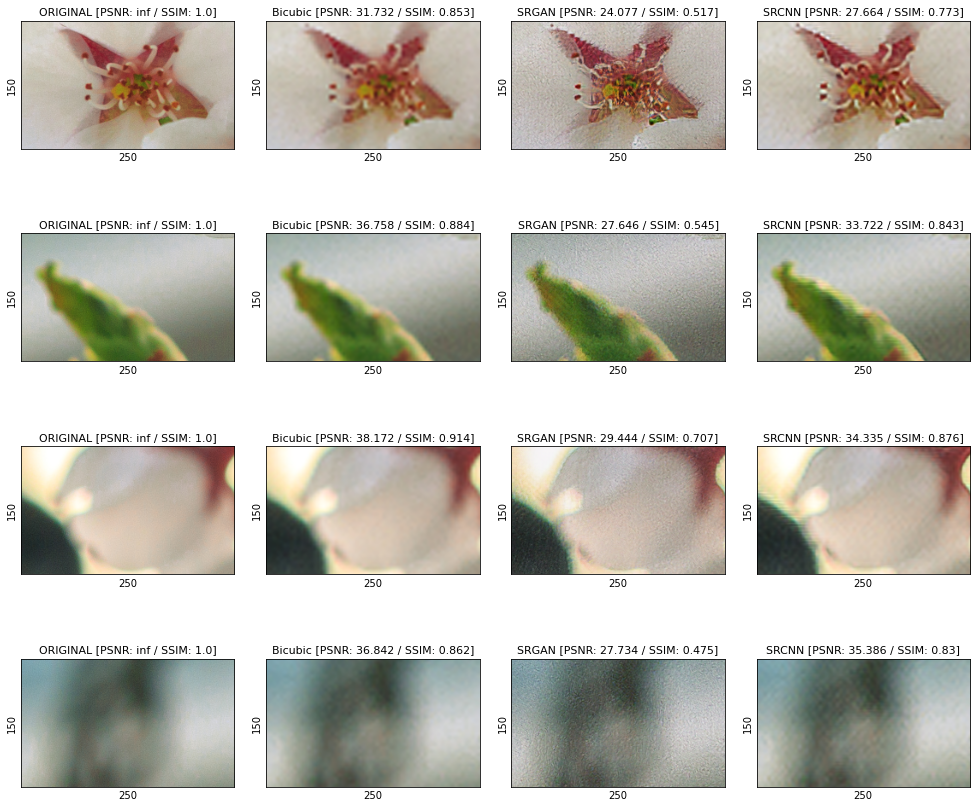

In [20]:
plt.figure(figsize=(17, 15))
plt.subplots_adjust(wspace=0.15)
for row, cut_xy in enumerate(cut_xy_list):
    origin_cut_img = crop_img(hana, cut_xy)

    cut_images = []
    for img in images:
        cut_images.append(crop_img(img, cut_xy))

    psnr, ssim = get_psnr_ssim(cut_images, origin_cut_img)

    for c in range(4):
        plt.subplot(len(cut_xy_list), 4, (row * 4 + c + 1))
        draw_sub_img(cut_images[c], "")
        plt.title(titles[c] + f" [PSNR: {psnr[c]} / SSIM: {ssim[c]}]", fontsize=11)

    

### '바다' 이미지 해상도 개선
바다 이미지에 대한 해상도 개선을 여부를 확인합니다. 바다 이미지 선택 이유는 파도와 물결 그리고 바위에 대한 질감의 해상도 개선 여부를 확인하기 위함 입니다. 파도의 경우 고차에 따른 그림자로 인해 밝기가 대조 되며, 바위의 경우에는 현무암의 구멍과 같은 질감으로 인해 밝기가 대조 됩니다.

### 이미지 해상도 개선
원본 이미지와 모델이 출력한 이미지의 차이를 나타내는 지표를 확인한 결과, Bicubic의 경우 PSNR이 28.281, SSIM이 0.815였고 SRGAN의 경우 PSNR이 19.677, SSIM이 0.389, SRCNN의 경우 PSNR이 24.314, SSIM이 0.715임을 확인 하였습니다. 육안으로 각 이미지를 비교하였을 때, SRGAN의 경우 파도의 질감이 매우 부드러워졌고 바위의 경우 더욱 선명해졌습니다. SRCNN의 경우 육안으로 큰 차이를 확인할 수 없었습니다.

#### 이미지 시각화
`IMAGE 3(바다)`의 원본 이미지를 시각화 합니다.

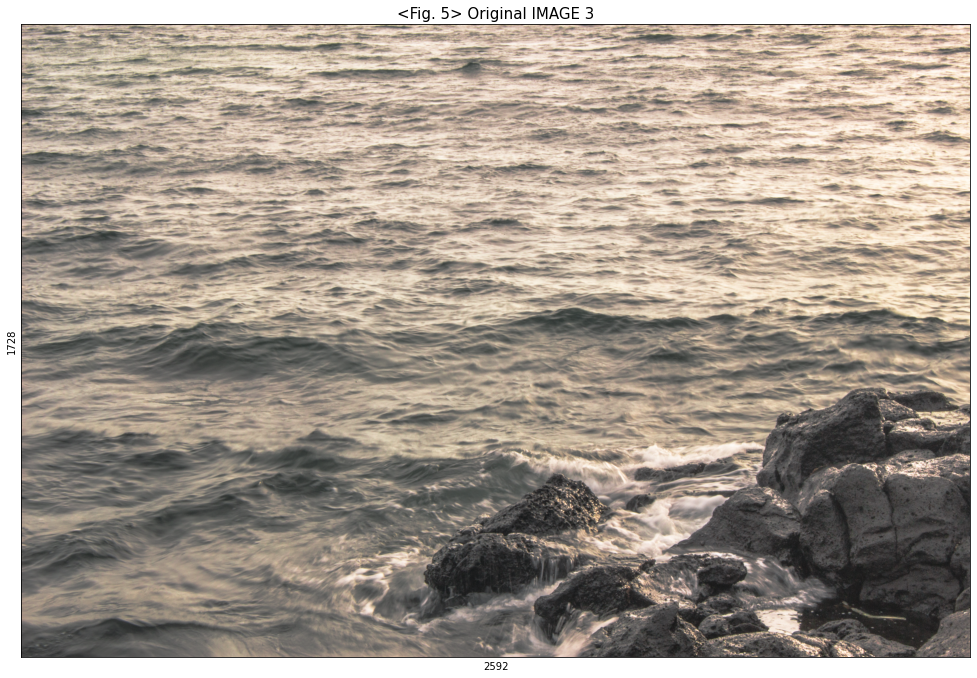

In [21]:
plt.figure(figsize=(17, 12))
draw_sub_img(umi, "<Fig. 5> Original IMAGE 3")
plt.show()

#### SRGAN, SRCNN 모델을 이용한 이미지 해상도 개선 실시
이전의 '이미지 축소', 'SRGAN을 이용한 해상도 개선', '이미지 확대(Bicubic)', 'SRCNN을 이용한 해상도 개선' 작업을 통합하여 실시 합니다.

In [22]:
bicubic_img = size_down_img(umi)
srgan_img = apply_srgan(bicubic_img)
bicubic_img = size_up_img(bicubic_img)
srcnn_img = apply_srcnn(bicubic_img)

#### 해상도 개선 결과 시각화
각 모델을 통해 개선된 해상도 이미지와 `PSNR` 및 `SSIM` 지표를 함께 시각화 합니다.순서대로 '원본 이미지', '축소 후 확대(Bicubic)', 'SRGAN의 출력 이미지', 'SRCNN의 출력 이미지' 입니다.원본 이미지와 모델이 출력한 이미지의 차이를 나타내는 지표를 확인한 결과, `Bicubic`의 경우 `PSNR`이 28.281, `SSIM`이 0.815였고 `SRGAN`의 경우 `PSNR`이 19.677, `SSIM`이 0.389, `SRCNN`의 경우 `PSNR`이 24.314, `SSIM`이 0.715임을 확인 하였습니다.

In [15]:
images = [umi, bicubic_img, srgan_img, srcnn_img]
titles = ["ORIGINAL", "Bicubic", "SRGAN", "SRCNN"]
psnr, ssim = get_psnr_ssim(images, umi)

plt.figure(figsize=(17, 48))

for i in range(4):
    plt.subplot(4, 1, i+1)
    title = titles[i] + f" [PSNR: {psnr[i]} / SSIM: {ssim[i]}]"
    draw_sub_img(images[i], title)

### 이미지 세부 영역 분석
세부 영역을 바위와 파도 중심으로 선정하여 해상도 개선을 확인하였습니다. 모든 영역에 대해 SRGAN이 SRCNN보다 PSNR 값이 낮고 SRCNN이 SRGAN보다 SSIM 값이 높은 것을 확인할 수 있었습니다.

#### 세부 영역 표시 하기
선택한 세부 영역은 총 네 개이며 선택 이유는 거리와 바위의 질감에 대한 해상도 개선 여부를 확인하기 위함 입니다.

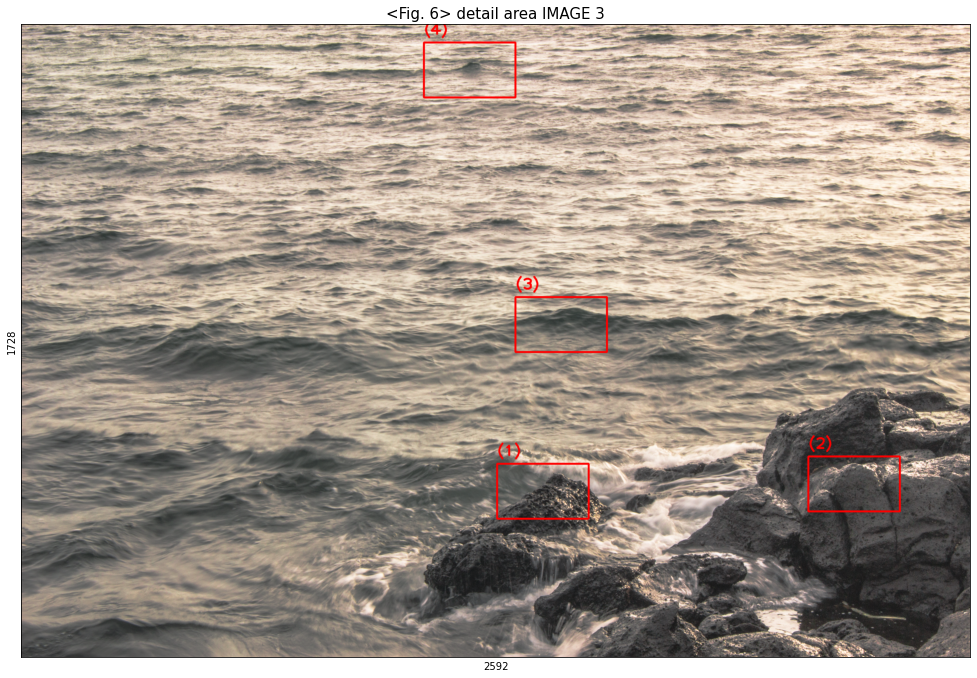

In [24]:
cut_xy_list = ((1300, 1200), (2150, 1180), (1350, 745), (1100, 50))
c_img = rect_img(umi, cut_xy_list)

plt.figure(figsize=(17, 12))
draw_sub_img(c_img, "<Fig. 6> detail area IMAGE 3")
plt.show()

#### 세부 영역별 PSNR & SSIM 확인
선택한 세부 영역에 대한 이미지와 `PSNR`, `SSIM` 지표를 시각화 합니다.
모든 영역에 대해 `SRGAN`이 `SRCNN`보다 `PSNR` 값이 낮고 `SRCNN`이 `SRGAN`보다 `SSIM` 값이 높은 것을 확인할 수 있습니다.

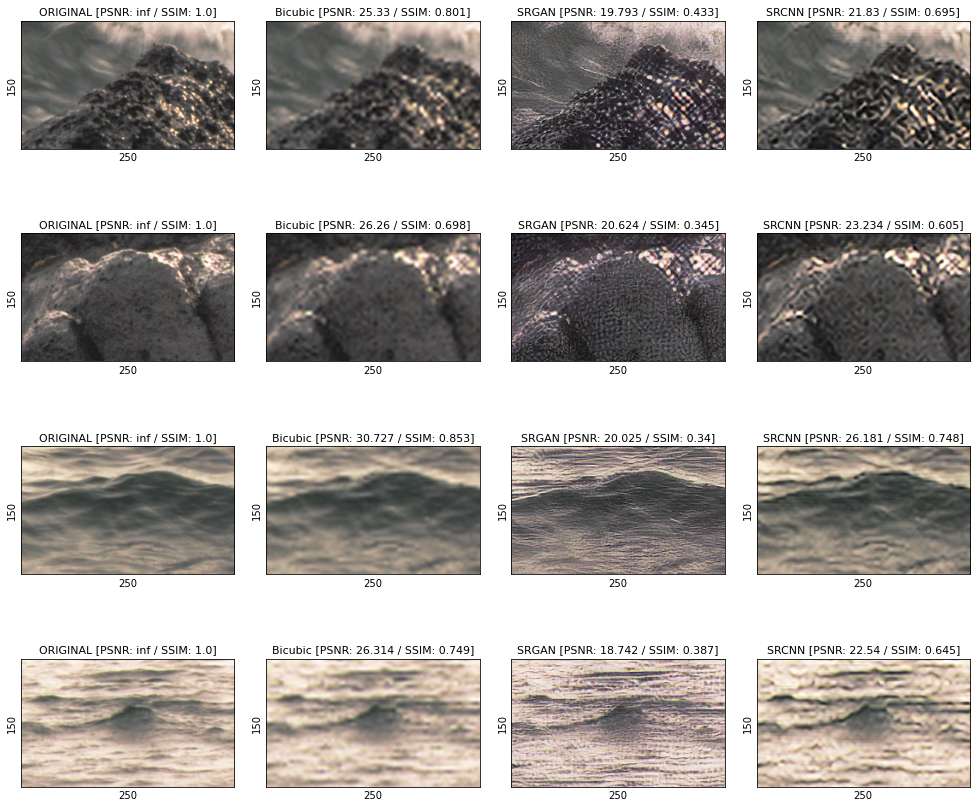

In [25]:
plt.figure(figsize=(17, 15))
plt.subplots_adjust(wspace=0.15)
for row, cut_xy in enumerate(cut_xy_list):
    origin_cut_img = crop_img(umi, cut_xy)

    cut_images = []
    for img in images:
        cut_images.append(crop_img(img, cut_xy))

    psnr, ssim = get_psnr_ssim(cut_images, origin_cut_img)

    for c in range(4):
        plt.subplot(len(cut_xy_list), 4, (row * 4 + c + 1))
        draw_sub_img(cut_images[c], "")
        plt.title(titles[c] + f" [PSNR: {psnr[c]} / SSIM: {ssim[c]}]", fontsize=11)

    

### '관람차' 이미지 해상도 개선
관람차 이미지에 대한 해상도 개선을 여부를 확인합니다. 관람차 이미지 선택 이유는 직선 형태의 철골 구조와 얇은 와이어에 대한 모델의 해상도 개선 여부를 확인하기 위함 입니다. 또한, 기구 내의 사람의 뒷모습 그리고 빛에 반사된 기구에 대한 해상도 개선 여부도 함께 확인하고자 합니다.

### 이미지 해상도 개선
원본 이미지와 모델이 출력한 이미지의 차이를 나타내는 지표를 확인한 결과, Bicubic의 경우 PSNR이 28.467, SSIM이 0.879였고 SRGAN의 경우 PSNR이 23.49, SSIM이 0.673, SRCNN의 경우 PSNR이 25.031, SSIM이 0.826임을 확인 하였습니다.

#### 이미지 시각화
`IMAGE 4(관람차)`의 원본 이미지를 시각화 합니다.

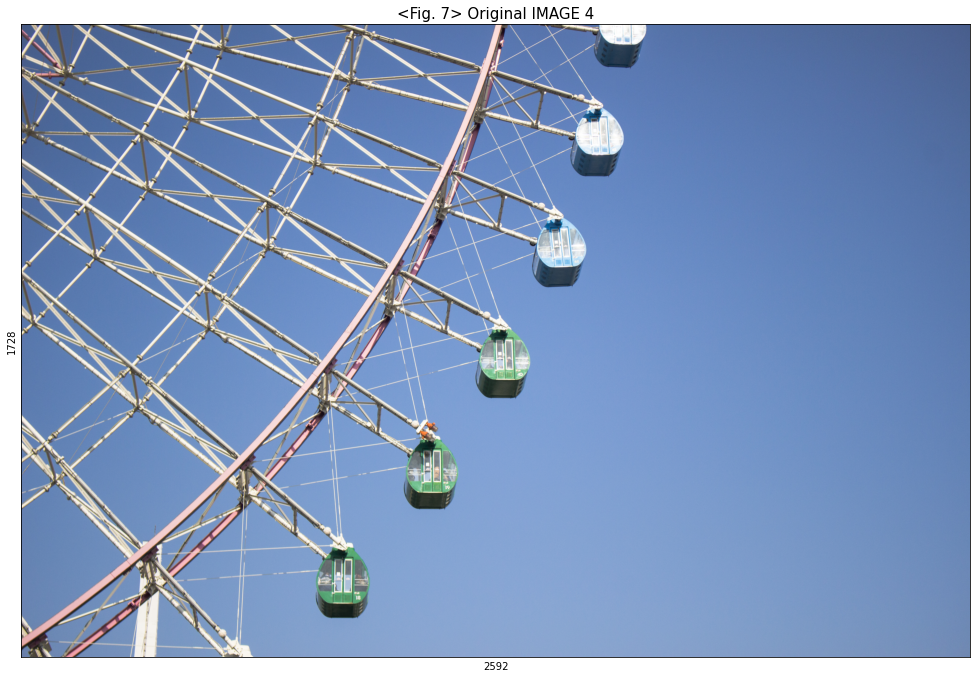

In [26]:
plt.figure(figsize=(17, 12))
draw_sub_img(kanran, "<Fig. 7> Original IMAGE 4")
plt.show()

#### SRGAN, SRCNN 모델을 이용한 이미지 해상도 개선 실시
이전의 '이미지 축소', 'SRGAN을 이용한 해상도 개선', '이미지 확대(Bicubic)', 'SRCNN을 이용한 해상도 개선' 작업을 통합하여 실시 합니다.

In [27]:
bicubic_img = size_down_img(kanran)
srgan_img = apply_srgan(bicubic_img)
bicubic_img = size_up_img(bicubic_img)
srcnn_img = apply_srcnn(bicubic_img)

#### 해상도 개선 결과 시각화 하기
각 모델을 통해 개선된 해상도 이미지와 `PSNR` 및 `SSIM` 지표를 함께 시각화 합니다.순서대로 '원본 이미지', '축소 후 확대(Bicubic)', 'SRGAN의 출력 이미지', 'SRCNN의 출력 이미지' 입니다.원본 이미지와 모델이 출력한 이미지의 차이를 나타내는 지표를 확인한 결과, `Bicubic`의 경우 `PSNR`이 28.467, `SSIM`이 0.879였고 `SRGAN`의 경우 `PSNR`이 23.49, `SSIM`이 0.673, `SRCNN`의 경우 `PSNR`이 25.031, `SSIM`이 0.826임을 확인 하였습니다.

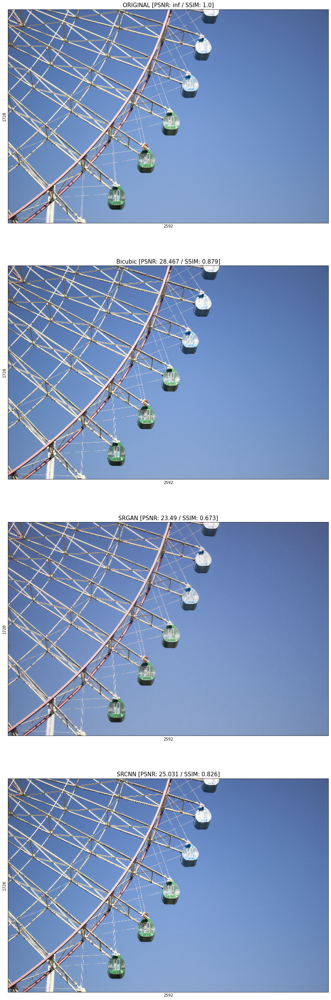

In [28]:
images = [kanran, bicubic_img, srgan_img, srcnn_img]
titles = ["ORIGINAL", "Bicubic", "SRGAN", "SRCNN"]
psnr, ssim = get_psnr_ssim(images, kanran)

plt.figure(figsize=(17, 48))

for i in range(4):
    plt.subplot(4, 1, i+1)
    title = titles[i] + f" [PSNR: {psnr[i]} / SSIM: {ssim[i]}]"
    draw_sub_img(images[i], title)

### 이미지 세부 영역 분석
세부 영역을 직선 형태의 구조물과 기구 내부의 인원, 빛에 반사된 기구로 구분하였습니다. 모든 영역에 대해 SRGAN이 SRCNN보다 PSNR 값이 낮고 SRCNN이 SRGAN보다 SSIM 값이 높은 것을 확인할 수 있었습니다.

#### 세부 영역 표시 하기
기구 내부의 사람에 대한 해상도 개선, 와이어 대한 해상도 개선, 철골 프레임 대한 해상도 개선, 빛이 반사되어 흐릿하게 보이는 객체에 대한 해상도 개선을 확인하기 위해 표시하였습니다.

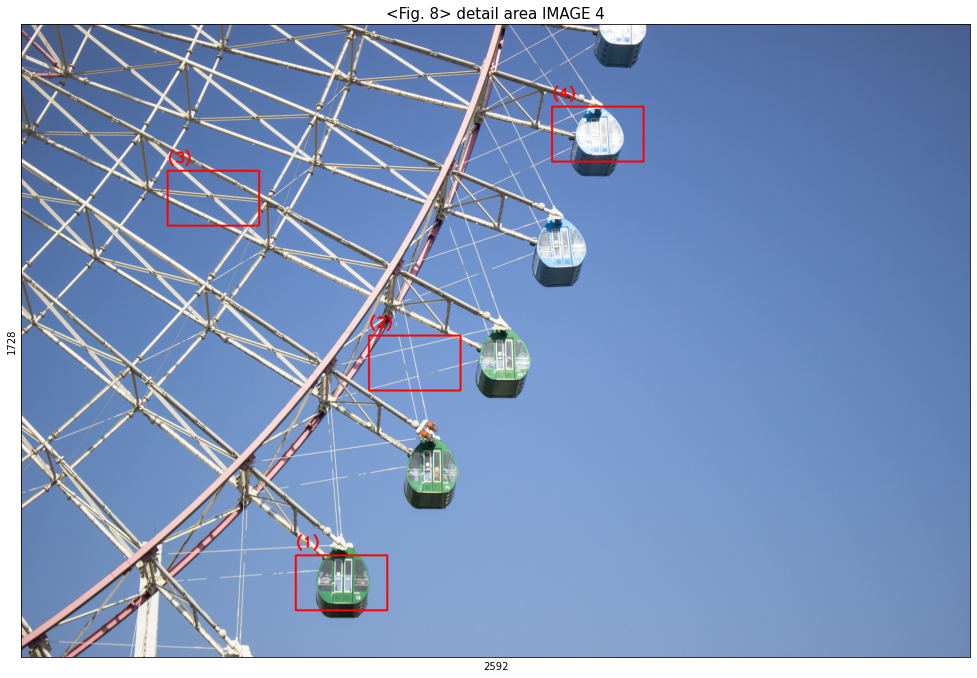

In [29]:
cut_xy_list = ((750, 1450), (950, 850), (400, 400), (1450, 225))
c_img = rect_img(kanran, cut_xy_list)

plt.figure(figsize=(17, 12))
draw_sub_img(c_img, "<Fig. 8> detail area IMAGE 4")
plt.show()

#### 세부 영역별 PSNR & SSIM 확인
선택한 세부 영역에 대한 이미지와 `PSNR`, `SSIM` 지표를 시각화 합니다.모든 영역에 대해 `SRGAN`이 `SRCNN`보다 `PSNR` 값이 낮고 `SRCNN`이 `SRGAN`보다 `SSIM` 값이 높은 것을 확인할 수 있습니다.

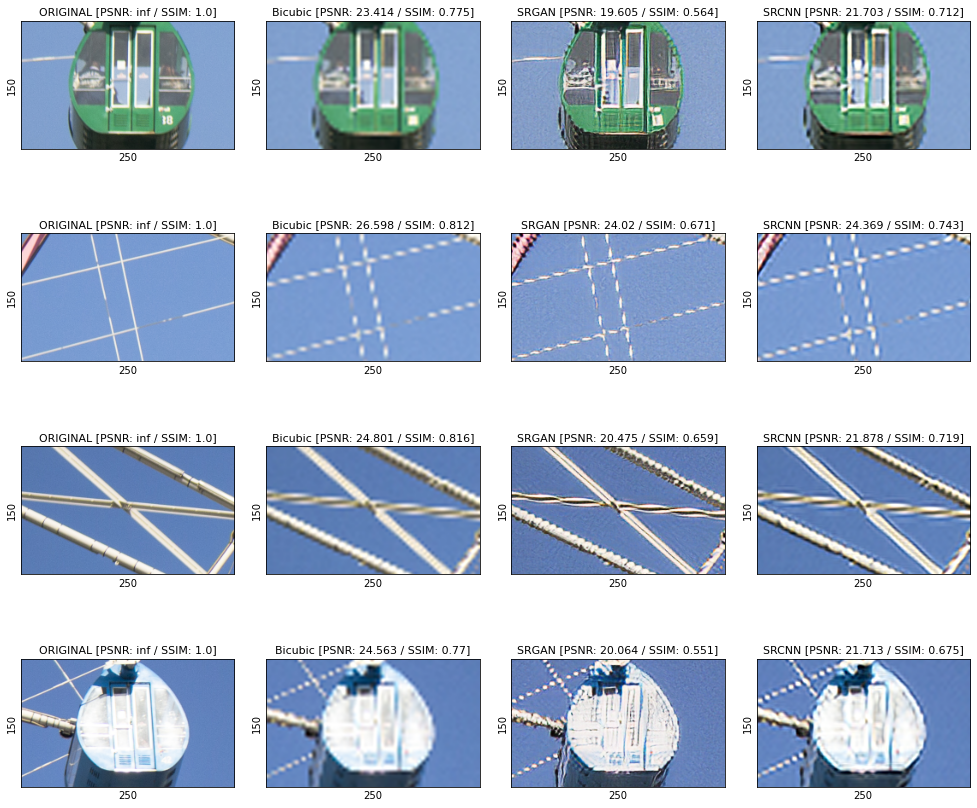

In [30]:
plt.figure(figsize=(17, 15))
plt.subplots_adjust(wspace=0.15)
for row, cut_xy in enumerate(cut_xy_list):
    origin_cut_img = crop_img(kanran, cut_xy)

    cut_images = []
    for img in images:
        cut_images.append(crop_img(img, cut_xy))

    psnr, ssim = get_psnr_ssim(cut_images, origin_cut_img)

    for c in range(4):
        plt.subplot(len(cut_xy_list), 4, (row * 4 + c + 1))
        draw_sub_img(cut_images[c], "")
        plt.title(titles[c] + f" [PSNR: {psnr[c]} / SSIM: {ssim[c]}]", fontsize=11)

    

## GIF 해상도 개선
이번 에는 GIF를 이용하여 해상도 개선 예제를 진행하고자 합니다. 해당 예제 또한 SRGAN, SRCNN 모델을 이용하여 해상도 개선을 진행한 후, 세부적인 부분을 선정하고 이를 중심으로 분석하고자 합니다.

### 바다 GIF 해상도 개선
바다 GIF의 해상도 개선 여부를 확인합니다. 바다 GIF는 총 98 프레임이고 이미지의 크기는 세로 360, 가로 640입니다. GIF의 특징은 해가 저물기 시작하는 시점에 촬영 하였기 때문에 야간에 촬영한 것과 같이 전체적으로 어두운 것을 확인할 수 있습니다.모델을 사용하여 해상도를 개선한 결과, SRGNN의 경우 ISO를 높인 것과 같이 노이즈가 증가 하였습니다. 또한, 성능이 좋지 않은 카메라로 촬영하였을 때 생기는 현상처럼 하늘과 모래 사장 부분에 파장과 같은 물결 형태가 생겼습니다. SRCNN의 경우 노이즈가 증가하였으며, 오히려 해상도가 감소하였습니다.

#### GIF 시각화
`show_gif`를 이용하여 시각화 할 수 있지만 용량을 위하여 markdown을 사용해 시각화 합니다.

In [31]:
show_gif("./dataset/movie.gif", width=500)

#### 프레임 획득 함수
GIF 파일로부터 각 프레임을 배열로 획득하는 함수를 생성 합니다.

In [32]:
def get_gif_frame(gif_path):
    gif = cv2.VideoCapture(gif_path)

    isTrue = True
    frames = []
    while isTrue:
        isTrue, frame = gif.read()
        if isTrue:
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            frames.append(frame)
    return frames

#### GIF 프레임 획득
앞서 생성한 `get_gif_frame` 함수를 이용하여 GIF의 프레임을 획득합니다. 총 프레임 수는 98이고 이미지의 크기는 세로 360, 가로 640 입니다.

In [33]:
frames = get_gif_frame("./dataset/movie.gif")

print("frame 수 :", len(frames))
print("frame 크기 :", (frames[0].shape))

frame 수 : 98
frame 크기 : (360, 640, 3)


#### 모델별 GIF 해상도 개선 함수 생성
각 모델에 프레임 별로 이미지를 입력하고 그 출력을 반환하는 함수를 생성 합니다.

In [34]:
def get_srgan_frames(frames):
    srgan_frames = []
    for img in frames:
        srgan_img = apply_srgan(img)
        srgan_img = cv2.resize(
            srgan_img,
            dsize=(int(srgan_img.shape[1] / 4), int(srgan_img.shape[0] / 4)),
            interpolation=cv2.INTER_CUBIC
        )
        srgan_frames.append(srgan_img)
    return srgan_frames


def get_srcnn_frames(frames):
    srcnn_frames = []
    for img in frames:
        srcnn_img = apply_srcnn(img)
        srcnn_frames.append(srcnn_img)
    return srcnn_frames

#### 모델별 GIF 저장하기
`SRGAN`과 `SRCNN`를 이용하여 해상도 개선을 한 후, 이를 GIF 파일로 저장 합니다.

In [35]:
srgan_frames = get_srgan_frames(frames)
imageio.mimsave("./dataset/srgan_movie.gif", srgan_frames)

srcnn_frames = get_srcnn_frames(frames)
imageio.mimsave("./dataset/srcnn_movie.gif", srcnn_frames)

### 세부 영역 분석
바다 GIF에 대한 세부 영역을 분석 합니다. 영역 선택은 앞서 설명한 SRGAN의 출력에서 발견되는 물결 형태가 발생하는 하늘과 모래사장 부분을 중심으로 이루어 졌습니다. 앞서 진행한 이미지에 대한 각 모델의 PSNR과 SSIM 차이는 SRGAN의 PSNR이 SRCNN에 비해 낮고, SRCNN의 SSIM이 SRGAN에 비해 높았습니다. 하지만 해당 예제에서는 SRGAN의 SSIM이 SRCNN에 비해 높은 것을 확인하였습니다. 세부영역을 확대한 결과 SRGAN의 출력에서 물결형태를 보다 확실하게 확인할 수 있습니다.

#### 세부 영역 표시
세부 영역은 총 두 개이며 선택 이유는 `SRGAN` 모델의 출력 GIF에서 부드럽지 않고 마치 파장과 같이 보이는 부분이 하늘과 땅에 있기에 이를 좀더 자세히 살펴보기 위함 입니다.

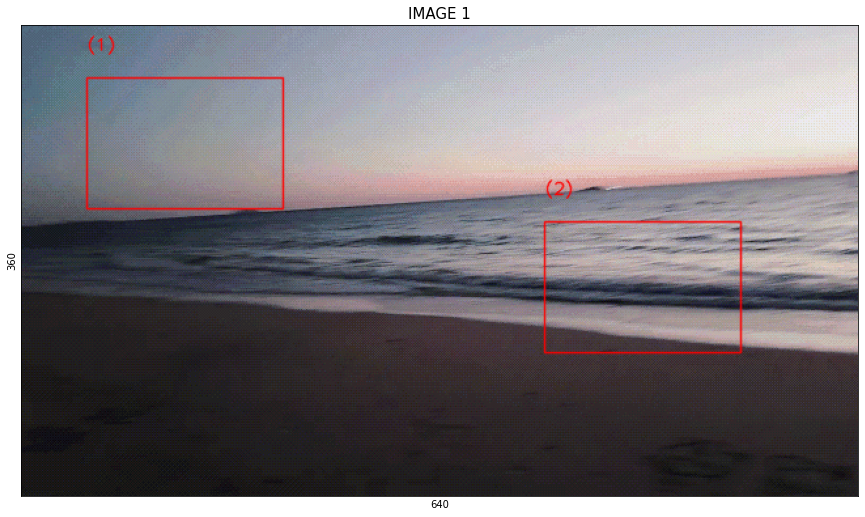

In [36]:
sample_img = frames[60]

cut_xy_list = ((50, 40), (400, 150))

c_img = rect_img(
    sample_img, cut_xy_list,
    rect_size_xy=(150, 100), font_size=1, line_width=1
)


plt.figure(figsize=(15, 10))
draw_sub_img(c_img, "IMAGE 1")
plt.show()

#### 모델별 GIF 불러오기
앞서 저장한 각 모델별 GIF를 불러옵니다.

In [37]:
origin_frames = get_gif_frame("./dataset/movie.gif")
srgan_frames = get_gif_frame("./dataset/srgan_movie.gif")
srcnn_frames = get_gif_frame("./dataset/srcnn_movie.gif")

#### 세부 영역 중심 GIF 재구성 하기
세부 영역별로 GIF를 자르고 `PSNR`, `SSIM` 지표가 표시되도록 GIF를 재구성 합니다.

In [38]:
cut_xy_list = ((50, 40), (400, 150))

titles = ("Original", "SRGAN", "SRCNN")

plt.figure(figsize=(17, 12))
plt.subplots_adjust(wspace=0.1)

for idx, each_img in enumerate(zip(origin_frames, srgan_frames, srcnn_frames)):
    psnr, ssim = get_psnr_ssim(each_img, each_img[0])
    
    for col, img in enumerate(each_img):
        plt.subplot(len(cut_xy_list) + 1, 3, col+1)
        draw_sub_img(img, "")
        plt.title(titles[col] + f" [PSNR: {psnr[col]} / SSIM: {ssim[col]}]", fontsize=11)
        
    for cut_idx, cut_xy in enumerate(cut_xy_list):
        cuted_each_img = [crop_img(img, cut_xy) for img in each_img]
        psnr, ssim = get_psnr_ssim(cuted_each_img, cuted_each_img[0])
        
        for col, img in enumerate(cuted_each_img):
            plt.subplot(len(cut_xy_list) + 1, 3, (cut_idx + 1) * 3 + col + 1)
            draw_sub_img(img, "")
            plt.title(titles[col] + f" [PSNR: {psnr[col]} / SSIM: {ssim[col]}]", fontsize=11)
    
    plt.savefig('./movie_png/{0}.png'.format(idx+1))
    plt.clf()

#### 세부 영역 중심 GIF 저장하기
재구성한 프레임을 GIF 파일로 저장 합니다.

In [39]:
gif_frames = []

for idx in range(len(origin_frames)):
    image_path = "./movie_png/{0}.png".format(idx+1)
    gif_frames.append(imageio.imread(image_path))
    
imageio.mimsave("./dataset/movie_all_model.gif", gif_frames)

### 게임 GIF 해상도 개선
게임 GIF의 해상도 개선 여부를 확인합니다. 게임 GIF는 총 157 프레임이고 이미지의 크기는 세로 480, 가로 720입니다. GIF의 특징은 원본 영상에서 특정한 격자 패턴이 확인된 다는 것입니다. 해당 패턴이 모델의 해상도 개선에 어떠한 영향을 미칠지 확인할 필요가 있습니다.

SRGNN의 경우 해당 격자가 부각되어 마치 TV를 가까이서 본 것과 같이 보입니다. SRCNN의 경우 '파티'에 대한 문자가 인식하기 어려울 정도로 해상도가 감소하였습니다.

#### GIF 시각화 
`show_gif`를 이용하여 시각화 할 수 있지만 용량을 위하여 markdown을 사용해 시각화 합니다.

In [40]:
show_gif("./dataset/movie2.gif", width=500)

#### GIF 프레임 획득하기
`get_gif_frame` 함수를 이용하여 GIF의 프레임을 획득합니다. 총 프레임 수는 157이고 이미지의 크기는 세로 480, 가로 720 입니다.

In [41]:
frames = get_gif_frame("./dataset/movie2.gif")

print("frame 수 :", len(frames))
print("frame 크기 :", (frames[0].shape))

frame 수 : 157
frame 크기 : (480, 720, 3)


#### 모델별 GIF 저장하기
`SRGAN`과 `SRCNN`를 이용하여 해상도 개선을 한 후, 이를 GIF 파일로 저장 합니다.

In [42]:
srgan_frames = get_srgan_frames(frames)
imageio.mimsave("./dataset/srgan_movie2.gif", srgan_frames)

srcnn_frames = get_srcnn_frames(frames)
imageio.mimsave("./dataset/srcnn_movie2.gif", srcnn_frames)

### 세부 영역 분석
게임 GIF에 대한 세부 영역을 분석 합니다. 영역 선택은 앞서 설명한 특정 격자와 게임 내의 캐릭터를 중심으로 선정하였습니다. 해당 예제에서 SRGAN의 SSIM이 SRCNN에 비해 높은 것을 확인하였습니다. 세부영역을 확대한 결과 SRGAN에서 특정 격자가 더 부각된 것을 확인할 수 있습니다. 하지만 오히려 SRCNN에서는 특정 격자가 감소하였습니다. 이는 SRCNN의 MSE로인한 효과로 추측 됩니다.

#### 세부 영역 표시
세부 영역은 총 두 개이며 선택 이유는 이미지로부터 격자 형태의 부분이 보여 이를 자세히 확인하기 위함과 게임 내의 캐릭터에 대한 해상도 개선을 확인하기 위함 입니다.

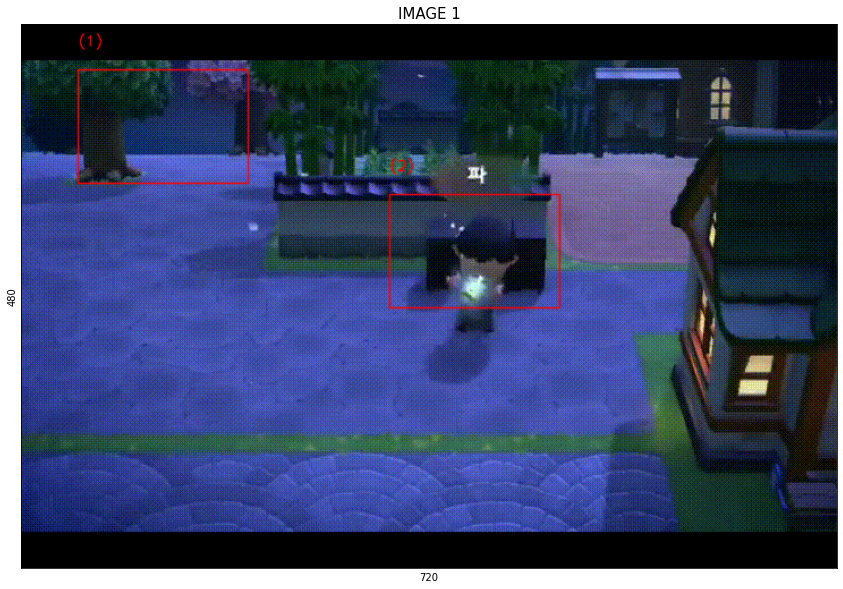

In [43]:
sample_img = frames[60]

cut_xy_list = ((50, 40), (325, 150))

c_img = rect_img(
    sample_img, cut_xy_list,
    rect_size_xy=(150, 100), font_size=1, line_width=1
)


plt.figure(figsize=(15, 10))
draw_sub_img(c_img, "IMAGE 1")
plt.show()

#### 모델별 GIF 불러오기
앞서 저장한 각 모델별 GIF를 불러옵니다.

In [44]:
origin_frames = get_gif_frame("./dataset/movie2.gif")
srgan_frames = get_gif_frame("./dataset/srgan_movie2.gif")
srcnn_frames = get_gif_frame("./dataset/srcnn_movie2.gif")

#### 세부 영역 중심 GIF 재구성 
세부 영역별로 GIF를 자르고 `PSNR`, `SSIM` 지표가 표시되도록 GIF를 재구성 합니다.

In [45]:
titles = ("Original", "SRGAN", "SRCNN")

plt.figure(figsize=(17, 12))
plt.subplots_adjust(wspace=0.1)

for idx, each_img in enumerate(zip(origin_frames, srgan_frames, srcnn_frames)):
    psnr, ssim = get_psnr_ssim(each_img, each_img[0])
    
    for col, img in enumerate(each_img):
        plt.subplot(len(cut_xy_list) + 1, 3, col+1)
        draw_sub_img(img, "")
        plt.title(titles[col] + f" [PSNR: {psnr[col]} / SSIM: {ssim[col]}]", fontsize=11)
        
    for cut_idx, cut_xy in enumerate(cut_xy_list):
        cuted_each_img = [crop_img(img, cut_xy) for img in each_img]
        psnr, ssim = get_psnr_ssim(cuted_each_img, cuted_each_img[0])
        
        for col, img in enumerate(cuted_each_img):
            plt.subplot(len(cut_xy_list) + 1, 3, (cut_idx + 1) * 3 + col + 1)
            draw_sub_img(img, "")
            plt.title(titles[col] + f" [PSNR: {psnr[col]} / SSIM: {ssim[col]}]", fontsize=11)
    
    plt.savefig('./movie_png/{0}.png'.format(idx+1))
    plt.clf()

#### 세부 영역 중심 GIF 저장하기
재구성한 프레임을 GIF 파일로 저장 합니다.

In [46]:
gif_frames = []

for idx in range(len(origin_frames)):
    image_path = "./movie_png/{0}.png".format(idx+1)
    gif_frames.append(imageio.imread(image_path))
    
imageio.mimsave("./dataset/movie2_all_model.gif", gif_frames)

## 결론
SRGAN과 SRCNN 모델을 이용하여 이미지 해상도 개선 예제를 진행하였습니다. SRGAN의 경우, 이미지를 선명하게 만들어 줍니다. 또한, 물결, 파도와 같은 이미지에 대해 해상도 개선이 뚜렷합니다. 먼 거리에 있는 객체에 대한 해상도 개선도 SRCNN 모델에 비해 성능이 좋습니다. 하지만, 특정 이미지에 대해 너무 각진 형태로 출력 됩니다. 또한, 야간에 촬영한 이미지를 입력할 경우 노이즈가 증가합니다. 원본에 존재하지 않는 특정 패턴이 생기기도 합니다. SRCNN의 경우, 이미지 뭉개지는 것 처럼 보이기도 합니다. 또, 특정 이미지에 대해서는 Bicubic을 통해 이미지를 확대한 것보다 해상도가 더 떨어지는 경우도 존재합니다. 대체로 Bicubic만 행한 것보다 선명한 이미지를 출력합니다.